<a href="https://colab.research.google.com/github/moey920/Object-Detection/blob/master/Detectron2_semi_final(0320).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 2. Detectron2 설치하기

# 새 섹션

In [1]:
# 종속 패키지(dependencies) 설치, 설치후에 Restart Runtime이 나오면 클릭해줍니다.
!pip install -U torch torchvision cython
!pip install -U 'git+https://github.com/facebookresearch/fvcore.git' 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__

Requirement already up-to-date: torch in /usr/local/lib/python3.6/dist-packages (1.4.0)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.6/dist-packages (0.5.0)
Requirement already up-to-date: cython in /usr/local/lib/python3.6/dist-packages (0.29.15)
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-z68ps_0z
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-z68ps_0z
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-nuvsggeo
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-nuvsggeo
     |████████████████████████████████| 276kB 45.7MB/s 
  Created wheel for fvcore: filename=fvcore-0.1-cp36-none-any.whl size=42829 sha256=8eedb809cc56a44d8c24341932d3597afdf617cd140d58ca8187cd8689e0bbe7
  Stored in directory: /tmp/pip-ephem-wheel-cache-bk4d1gtg/wheels/48/53/79/3c6485543a4455a0006f5db590ab9957622b6227011941de06
  Created wheel 

'1.4.0'

In [2]:
# Detectiorn2 repo 클론, 인스톨
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 61, done.
remote: Counting objects: 100% (61/61), done.
remote: Compressing objects: 100% (48/48), done.
remote: Total 3475 (delta 21), reused 33 (delta 12), pack-reused 3414
Receiving objects: 100% (3475/3475), 2.16 MiB | 29.87 MiB/s, done.
Resolving deltas: 100% (2384/2384), done.
Obtaining file:///content/detectron2_repo
  Running setup.py develop for detectron2


In [0]:
# 인스톨이 완료되면 Colab Runtime을 다시 시작해주세요. 

# 기본 설정
# detectron2 logger 설정
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# 자주 사용하는 라이브러리 임폴트
import numpy as np
import cv2
import random
import os
from google.colab.patches import cv2_imshow

# 자주 사용하는 detectron2 유틸 임폴트 
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# 1. Google Drive Api

In [0]:
# Google Drive api 활용, PyDrive package 인스톨
!pip install -U -q PyDrive

In [0]:
# Auth 승인을 받습니다. 코드 실행 시 링크가 나오면 들어가서 계정을 인증하고 인증 코드를 복사해 붙여넣습니다.
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
   
# PyDrive Authentication
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [0]:
# Folder Id로 FileList 받아오기
# 폴더 ID는 개인 드라이브에서 폴더에 들어가면 https://drive.google.com/drive/folders/ 이후에 나오는 주소입니다.

folder_id = '1R4bFN-68jn0Ug-gX4nWYTV0C87x6QN_2'
   
def ListFolder(parent):
    filelist=[]
    file_list = drive.ListFile({'q': "'%s' in parents and trashed=false" % parent}).GetList()
    for f in file_list:
        if f['mimeType']=='application/vnd.google-apps.folder': # if folder
            filelist.append({"id":f['id'],"title":f['title'],"list":ListFolder(f['id'])})
        else:
            filelist.append({"title":f['title'],"id":f['id']})
    return filelist
   
   
file_lists = ListFolder(folder_id)

In [0]:
# Local (colaboratory) directory 지정
# choose a local (colab) directory to store the data.
import os

local_download_path = os.path.expanduser('')
try:
	os.makedirs(local_download_path)
except: pass

In [6]:
# Filename 저장, 여기까지 하면 구글 드라이브 폴더 내의 파일을 Colab에 지정한 장소에 업로드 됩니다.
ret = []
for file in file_lists:
    print('title: %s, id: %s' % (file['title'], file['id']))
    fname = os.path.join(local_download_path, file['title'])
    print('downloading to {}'.format(fname))
    f_ = drive.CreateFile({'id': file['id']})
    f_.GetContentFile(fname)
    print(fname)
    ret.append(fname)

title: coco_instances_results.json, id: 1nIm14_ePpSgqytmjLrm3ZT1N7kF_apSM
downloading to coco_instances_results.json
coco_instances_results.json
title: model_final.pth, id: 19cKH3vgRNTCJz6_NSoH6QtL7vvVj435q
downloading to model_final.pth
model_final.pth
title: metrics.json, id: 1T-CS9qshdtkgAObM7YuCEef6RDNgabjt
downloading to metrics.json
metrics.json
title: last_checkpoint, id: 1owxW7Z2NlyB-AlKnKs1ec3kg3Ys9Q562
downloading to last_checkpoint
last_checkpoint
title: instances_predictions.pth, id: 1somrG8VDFM-lFRfjlTcqOo4xciX48Bzq
downloading to instances_predictions.pth
instances_predictions.pth
title: dataset.zip, id: 1zJScCWxOHfk0vRLnLGM6xRpTQiUKyGWw
downloading to dataset.zip
dataset.zip


In [7]:
#import os
#os.chdir('receipt')
!ls

adc.json		     detectron2_repo		metrics.json
coco_instances_results.json  instances_predictions.pth	model_final.pth
dataset.zip		     last_checkpoint		sample_data


In [0]:
# 업로드한 파일을 압축해제합니다.
!unzip dataset.zip > /dev/null

In [9]:
#os.chdir('../')
!ls

adc.json		     detectron2_repo		metrics.json	 train
coco_instances_results.json  instances_predictions.pth	model_final.pth  val
dataset.zip		     last_checkpoint		sample_data


# 커스텀 데이터셋 학습하기

In [0]:
# 인스톨이 완료되면 Colab Runtime을 다시 시작해주세요. 

# 기본 설정
# detectron2 logger 설정
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# 자주 사용하는 라이브러리 임폴트
import numpy as np
import cv2
import random
import os
from google.colab.patches import cv2_imshow
import matplotlib
import json

# 자주 사용하는 detectron2 유틸 임폴트 
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

In [0]:
import os
import numpy as np
import json
from detectron2.structures import BoxMode
import itertools
import cv2

def get_receipt_dicts(img_path,json_path):
    '''
    AD Oct 2019 : loading function to calculate the bboxes from the masks (as it does not exist so far in Detectron2)
    expected format:
    
    {'file_name': 'path/to/image',
    'height' : imgheight,
    'width': imgwidth,
    'annotations':
    [{'bbox': [xmin,ymin,xmax,ymax], 'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'segmentation': [[polygon/coordinates/x/y]],
    'category_id': 0, 'iscrowd': 0}, 
    {'bbox': [xmin2,ymin2,xmax2,ymax2], 'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'segmentation': [[polygon2/coordinates/x/y]],
    'category_id': 0, 'iscrowd': 0},
    
    etc ...]
    
    }
    INPUTS:
        img_path . str, path to the images
        json_path. str, path to the json annotation file (coco format)
    
    '''
    
    with open(json_path) as f:
        imgs_anns = json.load(f)
    dataset_dicts = []
    
    for img in imgs_anns['images']:
        record = {}
        
        filename = os.path.join(img_path,img['file_name'])
        height, width = cv2.imread(filename).shape[:2]
        image_id = img['id']

        record["file_name"] = filename
        record["height"] = height
        record["width"] = width
        
        for annos in imgs_anns['annotations']:
            if annos['image_id'] == image_id:

                objs = []
                poly = annos['segmentation']
                 
                for p in poly:
                    bbox=[]
                    x, y = p[::2] , p[1::2]
                    bbox.append(np.min(x))
                    bbox.append(np.min(y))
                    bbox.append(np.max(x))
                    bbox.append(np.max(y))
                    obj = {"bbox": bbox,
                            "bbox_mode": BoxMode.XYXY_ABS,
                            "segmentation": [p],
                            "category_id": 0,
                            "iscrowd": 0}
                    objs.append(obj)

        
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances

register_coco_instances("train", {}, "train/receipt_coco.json",
                        "train/")

register_coco_instances("val", {}, "val/receipt_coco.json",
                        "val/")

receipt_metadata_train = MetadataCatalog.get("train")
receipt_metadata_val = MetadataCatalog.get("val")

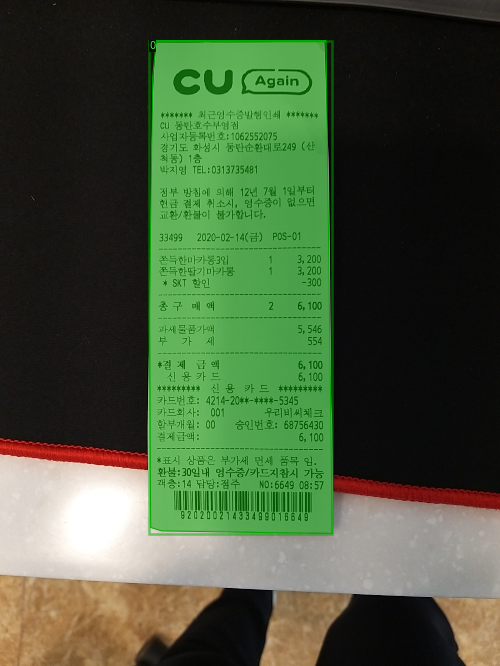

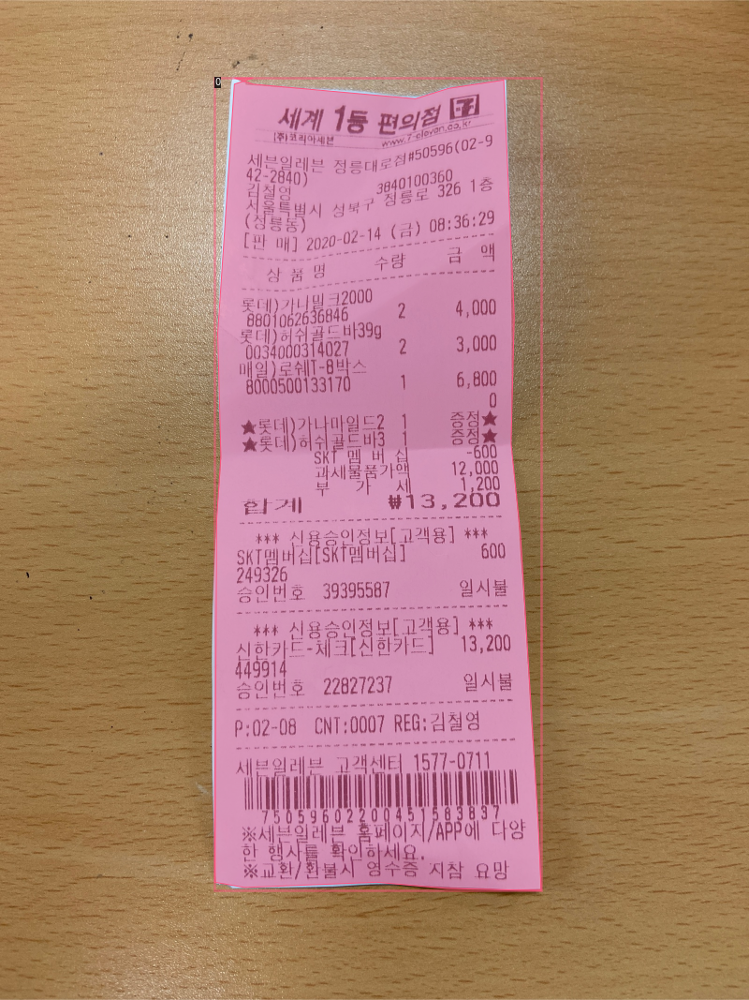

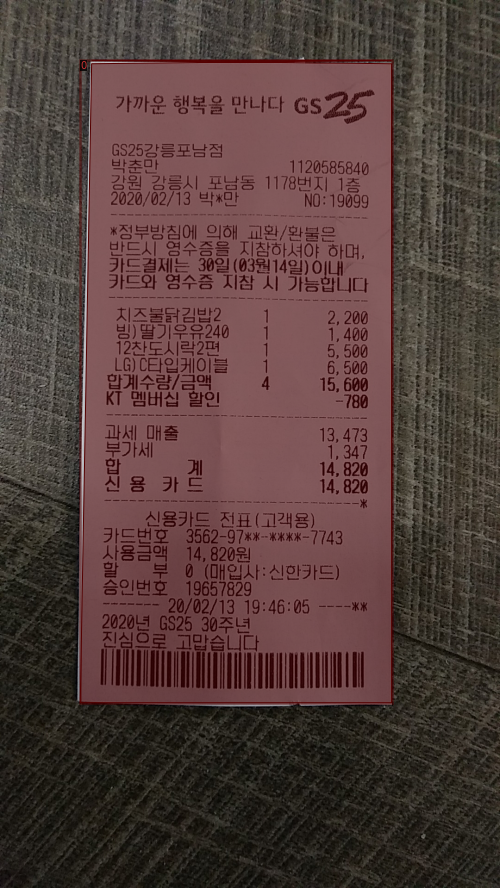

In [12]:
dataset_dicts = get_receipt_dicts("train","train/receipt_coco.json")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], receipt_metadata_train, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Object Detection

In [13]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file("./detectron2_repo/configs/COCO-Detection/retinanet_R_50_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"   # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 900
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # 클래스는 "영수증" 클래스 하나 뿐입니다.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

Loading config ./detectron2_repo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


[03/20 00:08:11 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

model_final_f10217.pkl: 178MB [00:08, 21.2MB/s]                           


[03/20 00:08:25 d2.engine.train_loop]: Starting training from iteration 0
[03/20 00:08:40 d2.utils.events]:  eta: 0:03:23  iter: 19  total_loss: 1.329  loss_cls: 1.075  loss_box_reg: 0.270  time: 0.7241  data_time: 0.0259  lr: 0.000005  max_mem: 3780M
[03/20 00:08:55 d2.utils.events]:  eta: 0:03:07  iter: 39  total_loss: 2.033  loss_cls: 1.578  loss_box_reg: 0.471  time: 0.7159  data_time: 0.0058  lr: 0.000010  max_mem: 3780M
[03/20 00:09:09 d2.utils.events]:  eta: 0:02:54  iter: 59  total_loss: 2.111  loss_cls: 1.633  loss_box_reg: 0.450  time: 0.7156  data_time: 0.0049  lr: 0.000015  max_mem: 3780M
[03/20 00:09:23 d2.utils.events]:  eta: 0:02:40  iter: 79  total_loss: 2.138  loss_cls: 1.644  loss_box_reg: 0.518  time: 0.7163  data_time: 0.0046  lr: 0.000020  max_mem: 3780M
[03/20 00:09:38 d2.utils.events]:  eta: 0:02:25  iter: 99  total_loss: 2.009  loss_cls: 1.572  loss_box_reg: 0.466  time: 0.7168  data_time: 0.0044  lr: 0.000025  max_mem: 3781M
[03/20 00:09:52 d2.utils.events]:  e

In [14]:
# tensorboard를 사용해서 학습 커브를 살펴봅니다.
%load_ext tensorboard
%tensorboard --logdir output

In [0]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
cfg.DATASETS.TEST = ("val", )
predictor = DefaultPredictor(cfg)

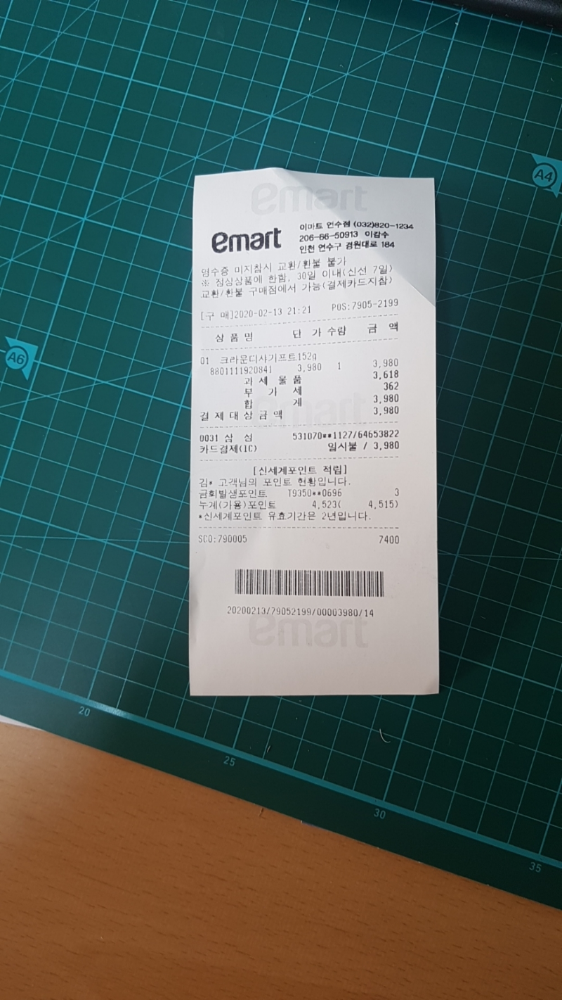

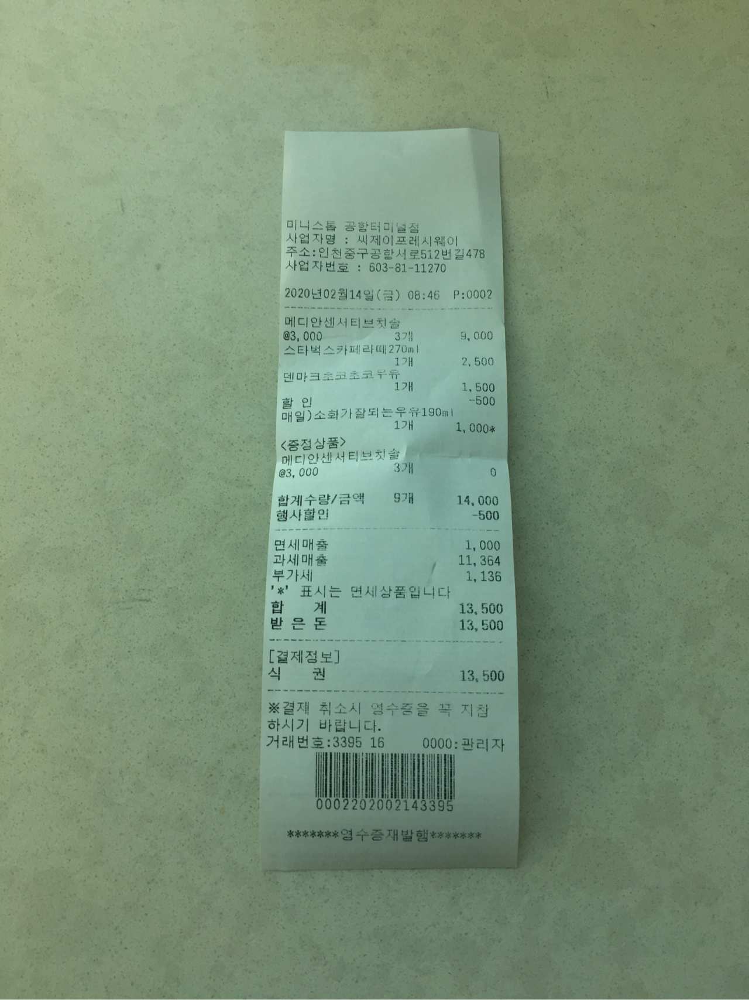

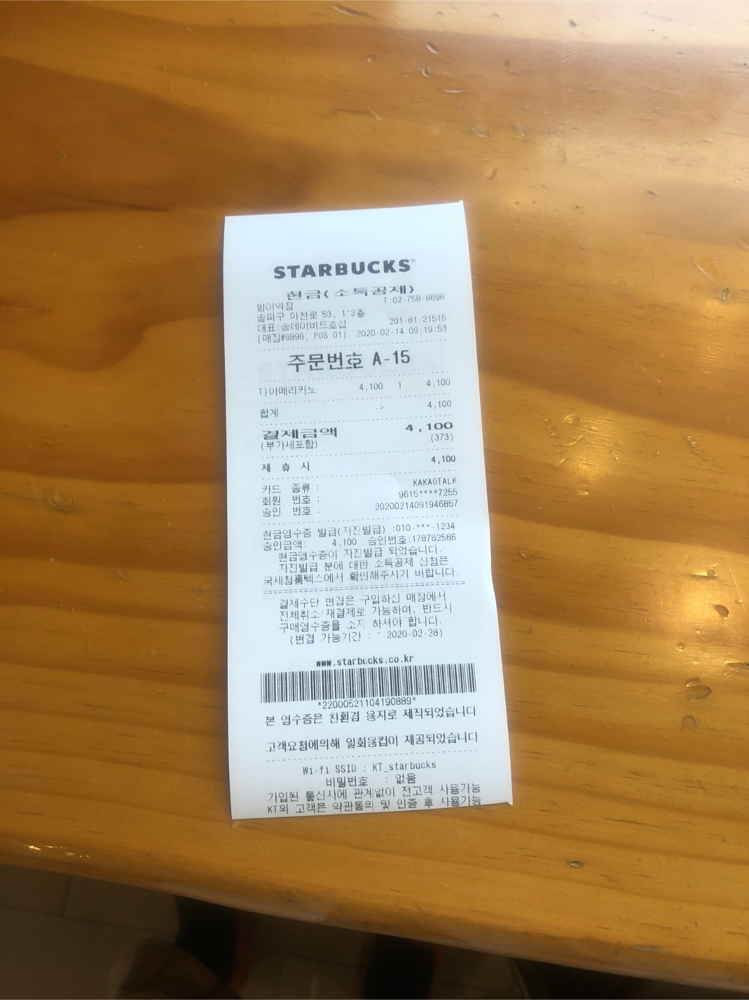

In [16]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_receipt_dicts("val","val/receipt_coco.json")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=receipt_metadata_train, 
                   scale=0.8
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [17]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "val")
inference_on_dataset(trainer.model, val_loader, evaluator)
# another equivalent way is to use trainer.test

[03/20 00:13:08 d2.data.datasets.coco]: Loaded 100 images in COCO format from val/receipt_coco.json
[03/20 00:13:08 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|  receipt   | 100          |
|            |              |
[03/20 00:13:08 d2.data.common]: Serializing 100 elements to byte tensors and concatenating them all ...
[03/20 00:13:08 d2.data.common]: Serialized dataset takes 0.05 MiB
[03/20 00:13:08 d2.evaluation.evaluator]: Start inference on 100 images
[03/20 00:13:11 d2.evaluation.evaluator]: Inference done 11/100. 0.2245 s / img. ETA=0:00:20
[03/20 00:13:16 d2.evaluation.evaluator]: Inference done 34/100. 0.2234 s / img. ETA=0:00:14
[03/20 00:13:21 d2.evaluation.evaluator]: Inference done 57/100. 0.2233 s / img. ETA=0:00:09
[03/20 00:13:26 d2.evaluation.evaluator]: Inference done 79/100. 0.2252 s / img. ETA=0:00:04
[03/20 00:13:31 d2.evaluation.evaluator]: Total inference time: 0:00:21.568942 (0.

OrderedDict([('bbox',
              {'AP': nan,
               'AP50': nan,
               'AP75': nan,
               'APl': nan,
               'APm': nan,
               'APs': nan})])

# Instance Segmentation

이제 학습을 진행할 단계입니다. COCO 데이터셋으로 학습된 R50-FPN Mask R-CNN 모델을 불러와서 영수증 데이터셋으로 fine-tune해 봅시다. Colab의 K80 GPU를 기준으로, 300 iterations 학습시키는데 대략 6분정도의 시간이 소요됩니다(P100 GPU의 경우 2분 가량 소요됩니다).

In [18]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file("./detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 900    # 300 iterations 정도면 충분합니다. 더 오랜 시간도 시도해보세요.
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 1024   # 영수증 데이터셋과 같이 적당한 데이터셋에서는 이정도면 적당합니다, 작은 데이터셋은 124로 하면 됩니다.
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # 클래스는 "영수증" 클래스 하나 뿐입니다.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[03/20 00:14:09 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (2, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (2,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (4, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (4,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (80,) in the checkpoint but (1,) in the model! Skipped.


[03/20 00:14:09 d2.engine.train_loop]: Starting training from iteration 0
[03/20 00:14:25 d2.utils.events]:  eta: 0:11:57  iter: 19  total_loss: 1.338  loss_cls: 0.590  loss_box_reg: 0.041  loss_mask: 0.696  loss_rpn_cls: 0.001  loss_rpn_loc: 0.009  time: 0.8056  data_time: 0.0209  lr: 0.000005  max_mem: 3781M
[03/20 00:14:41 d2.utils.events]:  eta: 0:11:33  iter: 39  total_loss: 1.185  loss_cls: 0.488  loss_box_reg: 0.040  loss_mask: 0.655  loss_rpn_cls: 0.001  loss_rpn_loc: 0.008  time: 0.7962  data_time: 0.0060  lr: 0.000010  max_mem: 3781M
[03/20 00:14:57 d2.utils.events]:  eta: 0:11:18  iter: 59  total_loss: 0.947  loss_cls: 0.311  loss_box_reg: 0.037  loss_mask: 0.575  loss_rpn_cls: 0.001  loss_rpn_loc: 0.010  time: 0.8018  data_time: 0.0052  lr: 0.000015  max_mem: 3781M
[03/20 00:15:14 d2.utils.events]:  eta: 0:11:07  iter: 79  total_loss: 0.762  loss_cls: 0.204  loss_box_reg: 0.041  loss_mask: 0.494  loss_rpn_cls: 0.001  loss_rpn_loc: 0.009  time: 0.8093  data_time: 0.0053  lr:

In [19]:
# tensorboard를 사용해서 학습 커브를 살펴봅니다.
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 695), started 0:25:50 ago. (Use '!kill 695' to kill it.)

# 학습한 모델 실행 및 평가하기

영수증 데이터셋의 검증(validation) 데이터셋으로 테스트를 해볼 차례입니다.

우선, 방금 전 학습한 모델을 불러와서 predictor를 생성합니다.

In [0]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
cfg.DATASETS.TEST = ("val", )
predictor = DefaultPredictor(cfg)

샘플을 몇 개 뽑아 살펴봅니다.

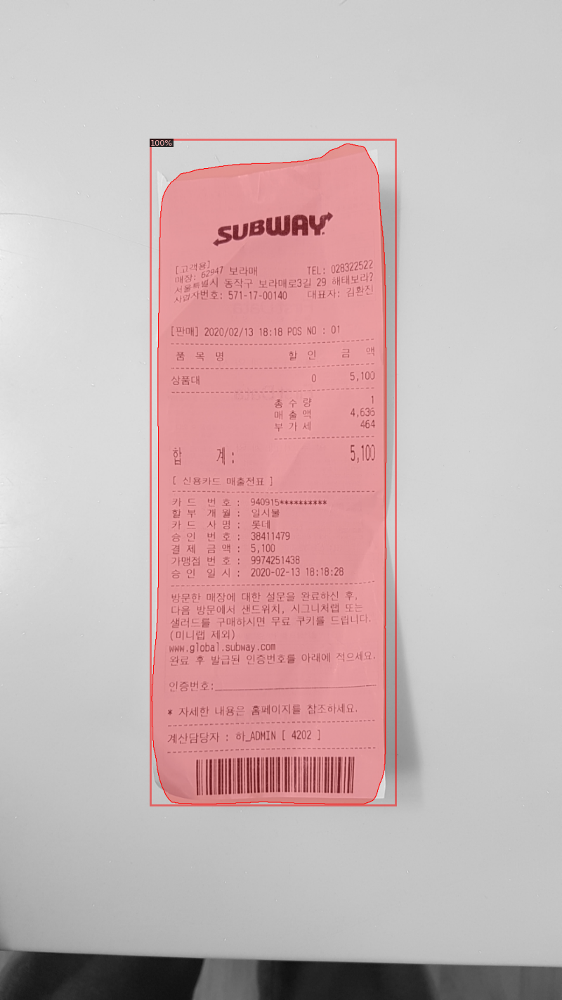

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


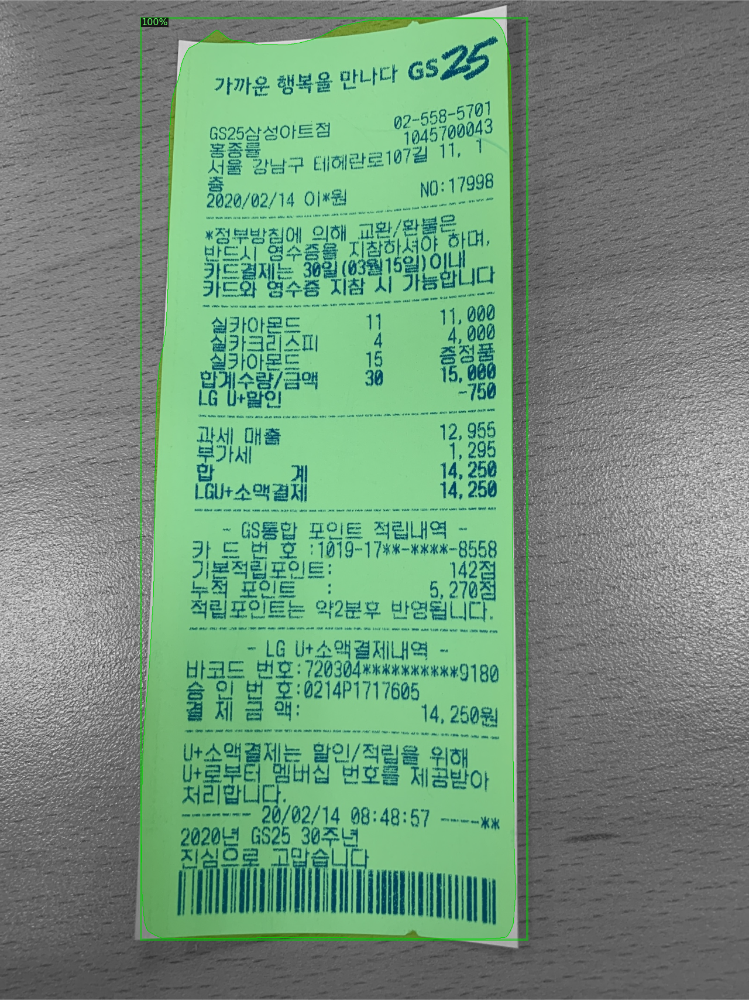

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


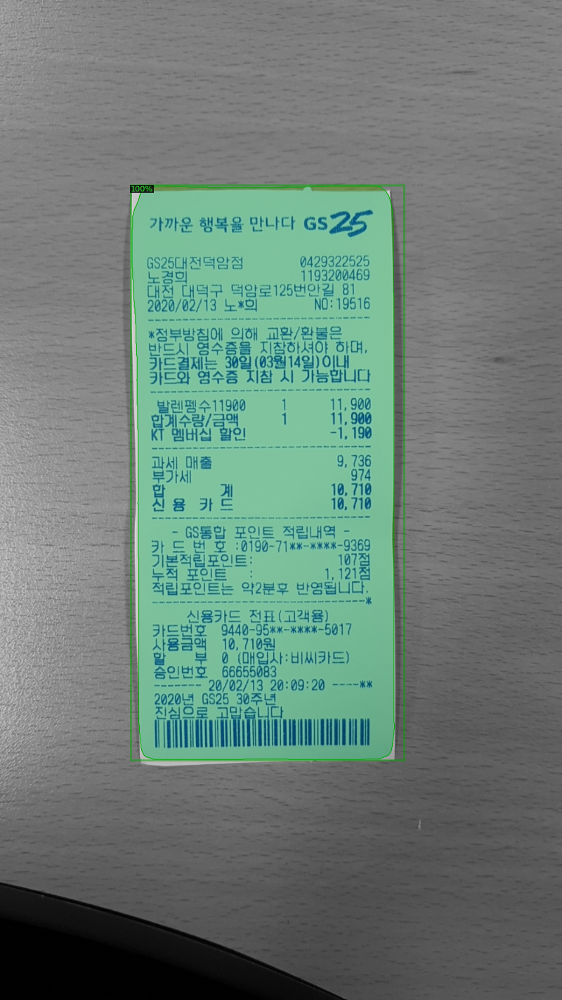

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


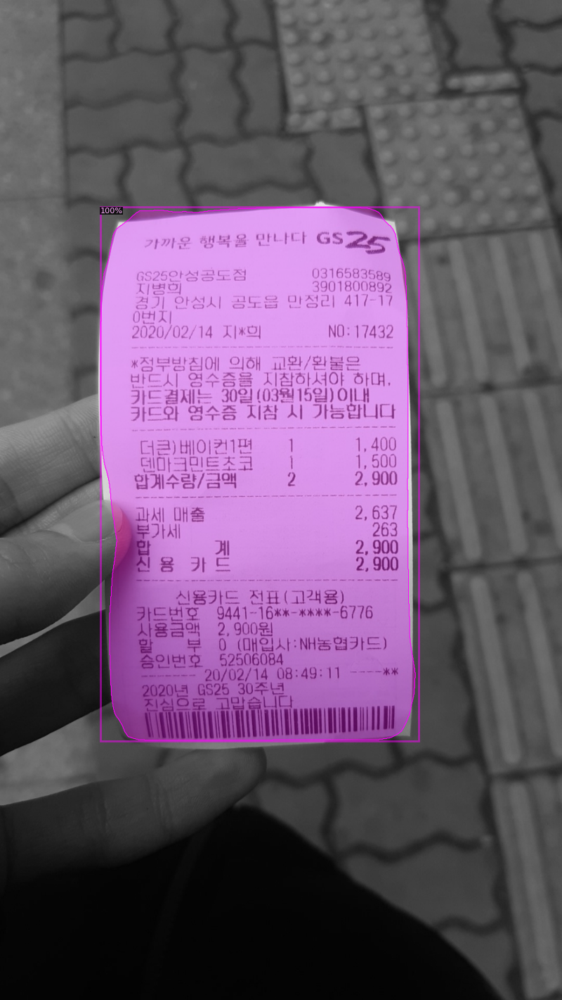

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


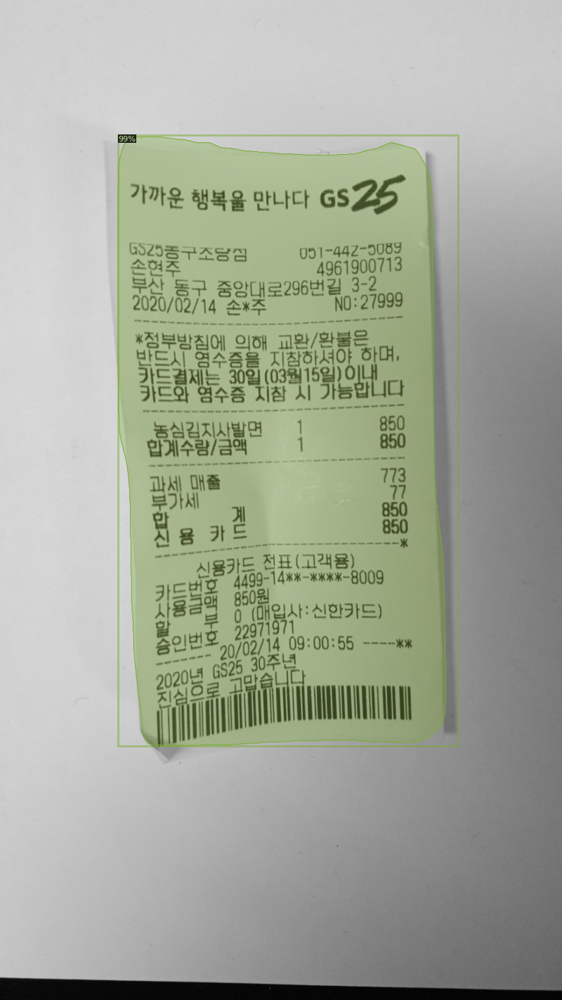

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [21]:
from detectron2.utils.visualizer import ColorMode
from detectron2.utils.visualizer import GenericMask
from detectron2.utils.visualizer import VisImage
from detectron2.structures import BitMasks, Boxes, BoxMode, Keypoints, PolygonMasks, RotatedBoxes
dataset_dicts = get_receipt_dicts("val","val/receipt_coco.json")
for d in random.sample(dataset_dicts, 5):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=receipt_metadata_train, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
                   #instance_mode=ColorMode.SEGMENTATION
                   #instance_mode = GenericMask.mask_to_polygons

    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])
    VisImage.save(v, "./output/")

In [22]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "val")
inference_on_dataset(trainer.model, val_loader, evaluator)
# another equivalent way is to use trainer.test

[03/20 00:38:50 d2.data.datasets.coco]: Loaded 100 images in COCO format from val/receipt_coco.json
[03/20 00:38:50 d2.data.common]: Serializing 100 elements to byte tensors and concatenating them all ...
[03/20 00:38:50 d2.data.common]: Serialized dataset takes 0.05 MiB
[03/20 00:38:50 d2.evaluation.evaluator]: Start inference on 100 images
[03/20 00:38:52 d2.evaluation.evaluator]: Inference done 11/100. 0.1623 s / img. ETA=0:00:16
[03/20 00:38:58 d2.evaluation.evaluator]: Inference done 37/100. 0.1632 s / img. ETA=0:00:12
[03/20 00:39:03 d2.evaluation.evaluator]: Inference done 64/100. 0.1647 s / img. ETA=0:00:06
[03/20 00:39:08 d2.evaluation.evaluator]: Inference done 90/100. 0.1664 s / img. ETA=0:00:01
[03/20 00:39:09 d2.evaluation.evaluator]: Total inference time: 0:00:18.215290 (0.191740 s / img per device, on 1 devices)
[03/20 00:39:09 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:15 (0.165726 s / img per device, on 1 devices)
[03/20 00:39:09 d2.evaluation.co

OrderedDict([('bbox',
              {'AP': 91.13390234936848,
               'AP50': 100.0,
               'AP75': 100.0,
               'APl': 91.13390234936848,
               'APm': nan,
               'APs': nan}),
             ('segm',
              {'AP': 99.54116613461052,
               'AP50': 100.0,
               'AP75': 100.0,
               'APl': 99.54116613461052,
               'APm': nan,
               'APs': nan})])

In [23]:
!ls output

coco_instances_results.json			   last_checkpoint
events.out.tfevents.1584662896.673924d373f5.517.0  metrics.json
events.out.tfevents.1584663249.673924d373f5.517.1  model_final.pth
instances_predictions.pth


# 구글 드라이브에 모델 저장하기

In [24]:
# 1. Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

# 2. Create & upload a file text file.
# 특정 폴더 안으로 파일 삽입
uploaded = drive.CreateFile({'title': 'coco_instances_results.json', "parents": [{"kind": "drive#fileLink","id": '1R4bFN-68jn0Ug-gX4nWYTV0C87x6QN_2'}]})
uploaded.SetContentString('Sample upload file content')
uploaded.SetContentFile('output/coco_instances_results.json')
uploaded.Upload()
print('Uploaded file with ID {}'.format(uploaded.get('id')))
# 3. Load a file by ID and print its contents.
downloaded = drive.CreateFile({'id': uploaded.get('id')})

Uploaded file with ID 1J_C3btlceeRrdg5lE5ESy5CXW4F2OU-n


In [25]:
for key in outputs.keys():
    print(key, ":", outputs[key])
    print(outputs['instances'].pred_masks)

instances : Instances(num_instances=1, image_height=1777, image_width=1000, fields=[pred_boxes: Boxes(tensor([[ 210.4355,  241.5132,  815.0264, 1325.6904]], device='cuda:0')), scores: tensor([0.9884], device='cuda:0'), pred_classes: tensor([0], device='cuda:0'), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]], device='cuda:0')])
tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, Fal

In [26]:
with open('output/coco_instances_results.json') as f :
    json_data = json.load(f)
json_data

[{'bbox': [258.81982421875, 50.857177734375, 1022.83984375, 1995.3037109375],
  'category_id': 1,
  'image_id': 1,
  'score': 0.9980427026748657,
  'segmentation': {'counts': 'UWo`0]6gj1R3`lNmHf7T9YFgHn7`8kFoHi7m7_GXIZ7a7THUIR7`7^HSIk6a7fHQId6b7mHPI^6`7VIoHX6a7[InHS6a7aIPIm5\\7iI[I_5o6XJgIR5b6eJSJf4V6RK]JZ4l5`K[JV4n5dKZJQ4o5iKXJm3Q6mKWJh3R6RLWJa3S6XLWJ[3T6^LUJT3W6eLSJm2Y6kLQJb2_6WMlIU2f6aMZJW1Y6_NWKF`5NUKQOc5c0TKSNl5`1mJPLX7a3]l0A>B:F9F:G9G8H8G8I7I7H8I6J6I6K4L4L4L3N3L4M2N2O1N2O001N2O1O0O2O1O0O2O001N2O001O0O2O001N101O0O2O00001N101O001N10001O0O100000000O100000000O10000000000O10001O00000O10000000000O1000000000000O100000000000000001O000000000000000000000000000000000000000000000000001O000000000000000000000000000000000000000000000000000000001O000000000000000000000000000000000000O1000000000000000000000000000000000000000000O10000000000000000000000000000000000000000000000000000O1000000000000000000000000000000000000001O00000000000000001O000000000000001O000000000000001O0000000000001OO100000000000

# BBOX CROP

In [0]:
data_file = open('/content/drive/My Drive/datt/coco_instances_results.json', "r") 
#json_file = open('output/coco_instances_results.json', "r")

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [7]:
import json
from collections import OrderedDict
 
with open('output/coco_instances_results.json', encoding="utf-8") as data_file:    
    data = json.load(data_file)#, object_pairs_hook=OrderedDict)


for item in data :
  print('id', item['image_id'], 'bbox', item['bbox'])

FileNotFoundError: ignored

In [2]:
import json
from collections import OrderedDict
 
with open('output/coco_instances_results.json', encoding="utf-8") as data_file:    
    data = json.load(data_file)#, object_pairs_hook=OrderedDict)


for item in data :
  print('id', item['image_id'], 'bbox', item['bbox'])

FileNotFoundError: ignored

In [1]:
x = list({i['image_id'] : i for i in data}.values())
x

NameError: ignored

In [0]:
items = [{'image_id': 85, 'category_id': 1, 'bbox': [412.3549499511719, 1125.603759765625, 680.00537109375, 920.078369140625], 'score': 0.07148899137973785}, 
        {'image_id': 85, 'category_id': 1, 'bbox': [412.3549499511719, 1125.603759765625, 680.00537109375, 920.078369140625], 'score': 0.07148899137973785},
        {'image_id': 86, 'category_id': 1, 'bbox': [454.5762023925781, 299.02099609375, 725.3507080078125, 1625.42431640625], 'score': 0.997811496257782} ]

In [124]:
print(items[2])

{'image_id': 86, 'category_id': 1, 'bbox': [454.5762023925781, 299.02099609375, 725.3507080078125, 1625.42431640625], 'score': 0.997811496257782}


In [127]:
print(data[1]['image_id'])

2


In [102]:
import json
from collections import OrderedDict
 
with open('output/coco_instances_results.json', encoding="utf-8") as data_file:    
    data = json.load(data_file)#, object_pairs_hook=OrderedDict)
i = 0
for i in data :
    while data[i]['image_id'] == data[i-1]['image_id'] :
           del data[i]
    print(data)
#i['image_id'] == j['image_id'] and i['bbox'] != j['bbox'] and            

TypeError: ignored